## WB/Step 1: Analysis of Data Set

In [42]:
import os
import pathlib
from collections import Counter

import numpy as np
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow.keras.utils import image_dataset_from_directory, plot_model
from tensorflow.keras import layers, losses, optimizers, applications, models
from tensorflow.keras.callbacks import EarlyStopping,ReduceLROnPlateau
from tensorflow.keras.applications import EfficientNetV2B0, MobileNetV3Small
from tensorflow.keras.optimizers.legacy import Adam
from tensorflow.keras import mixed_precision

os.environ["CUDA_VISIBLE_DEVICES"]="-1"    


# Ignore Warnings
import warnings
warnings.filterwarnings("ignore")

In [43]:
# constants

SEED = 7000
# intially idea was to use (128, 128), but than accuracy was really bad
image_size = (256, 256)
image_shape = image_size + (3,)

BATCH_SIZE = 32

path = "./data/crop/"
data_dir = pathlib.Path(path)

In [44]:
# Splitting full dataset to testing and training

print('Train data')
train_df = image_dataset_from_directory(data_dir,
                                          validation_split=0.3,
                                          subset='training',
                                          seed=SEED,
                                          shuffle=True,
                                          image_size=image_size,
                                          interpolation='bilinear',
                                          color_mode='rgb',
                                          batch_size=BATCH_SIZE
                                          )
train_df
print('\nValidation data')
validation_df = image_dataset_from_directory(data_dir,
                                               validation_split=0.3,
                                               subset='validation',
                                               shuffle = True,       
                                               seed=SEED,
                                               image_size=image_size,
                                               interpolation='bilinear',
                                               color_mode='rgb',
                                               batch_size=BATCH_SIZE)

validation_df

print('\nTraining dataset: ' + str(train_df))
print('There is {} images in the training dataset'.format(len(train_df)))
print('Validation dataset: ' + str(validation_df))
print('There is {} images in the validation dataset'.format(len(validation_df)))

Train data
Found 27564 files belonging to 60 classes.
Using 19295 files for training.

Validation data
Found 27564 files belonging to 60 classes.
Using 8269 files for validation.

Training dataset: <_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>
There is 603 images in the training dataset
Validation dataset: <_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>
There is 259 images in the validation dataset


In [45]:
class_names = train_df.class_names

def plot_images_from_df(ds, class_names):
    plt.figure(figsize = (20, 20))
    for images, labels in ds.take(1):
        for i in range(25):
            ax = plt.subplot(5, 5, i + 1)
            plt.imshow(images[i].numpy().astype("uint8"))
            plt.title(class_names[labels[i]] + " " + str(images[i].shape))

def visualize_sample_images_vertical(dataset, class_names, samples_per_class=5):
    class_images = {class_name: [] for class_name in class_names}
    
    for images, labels in dataset:
        for img, label in zip(images, labels):
            class_name = class_names[label]
            if len(class_images[class_name]) < samples_per_class:
                class_images[class_name].append(img.numpy().astype("uint8"))
        
        if all(len(imgs) == samples_per_class for imgs in class_images.values()):
            break
    
    num_classes = len(class_names)
    fig, axes = plt.subplots(nrows=num_classes, ncols=samples_per_class + 1, 
                             figsize=(3 * (samples_per_class + 1), 2 * num_classes))    
    for i, (class_name, imgs) in enumerate(class_images.items()):
        # Class name
        axes[i, 0].text(0.5, 0.5, class_name, rotation=0, ha='center', va='center', fontsize=10)
        axes[i, 0].axis('off')
        
        # Sample images
        for j, img in enumerate(imgs):
            axes[i, j+1].imshow(img)
            axes[i, j+1].axis('off')
    
    plt.tight_layout()
    plt.show()

def visualize_label_distribution(dataset, class_names, title):
    # Collect all labels
    all_labels = []
    for _, labels in dataset:
        all_labels.extend(labels.numpy())

    # Count occurrences of each label
    label_counts = Counter(all_labels)

    # Create a dictionary with class names and their counts
    class_counts = {class_names[i]: label_counts[i] for i in range(len(class_names))}

    # Sort the dictionary by value (count) in descending order
    sorted_class_counts = dict(sorted(class_counts.items(), key=lambda item: item[1], reverse=True))

    # Prepare data for plotting
    classes = list(sorted_class_counts.keys())
    counts = list(sorted_class_counts.values())

    # Set up the plot
    plt.figure(figsize=(12, max(8, len(classes) * 0.3)))  # Adjust height based on number of classes
    
    # Create color palette
    colors = sns.color_palette("husl", len(classes))
    
    # Create the horizontal bar plot
    ax = sns.barplot(y=classes, x=counts, palette=colors, orient='h')
    
    # Customize the plot
    plt.title(title, fontsize=20, pad=20)
    plt.xlabel('Count', fontsize=14, labelpad=10)
    plt.ylabel('Class', fontsize=14, labelpad=10)
    plt.yticks(fontsize=10)
    plt.xticks(fontsize=10)

    # Add count labels at the end of each bar
    for i, count in enumerate(counts):
        ax.text(count, i, f' {count}', va='center', fontweight='bold')

    # Add percentage labels inside each bar
    total = sum(counts)
    for i, count in enumerate(counts):
        percentage = count / total * 100
        ax.text(count/2, i, f'{percentage:.1f}%', ha='center', va='center', 
                color='white', fontweight='bold')

    # Remove top and right spines
    sns.despine()

    # Add a light grid
    ax.xaxis.grid(True, linestyle='--', alpha=0.7)

    # Tight layout to prevent clipping of labels
    plt.tight_layout()

    # Show the plot
    plt.show()

    # Print some statistics
    print(f"Total number of samples: {total}")
    print(f"Number of classes: {len(classes)}")
    print(f"Most common class: {classes[0]} ({counts[0]} samples, {counts[0]/total*100:.2f}%)")
    print(f"Least common class: {classes[-1]} ({counts[-1]} samples, {counts[-1]/total*100:.2f}%)")
    print(f"Imbalance ratio (most common / least common): {counts[0] / counts[-1]:.2f}")

def compare_class_distribution(train_ds, val_ds, class_names):
    def get_class_counts(dataset):
        all_labels = []
        for _, labels in dataset:
            all_labels.extend(labels.numpy())
        return dict(Counter(all_labels))

    train_counts = get_class_counts(train_ds)
    val_counts = get_class_counts(val_ds)

    plt.figure(figsize=(15, 8))
    x = np.arange(len(class_names))
    width = 0.35

    plt.bar(x - width/2, [train_counts.get(i, 0) for i in range(len(class_names))], width, label='Train', color='skyblue')
    plt.bar(x + width/2, [val_counts.get(i, 0) for i in range(len(class_names))], width, label='Validation', color='lightgreen')

    plt.xlabel('Classes')
    plt.ylabel('Count')
    plt.title('Class Distribution: Training vs Validation')
    plt.xticks(x, class_names, rotation=90)
    plt.legend()
    plt.tight_layout()
    plt.show()

Training Dataset Distribution:


2024-08-05 12:51:16.860684: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype int32 and shape [19295]
	 [[{{node Placeholder/_4}}]]
2024-08-05 12:51:16.861207: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [19295]
	 [[{{node Placeholder/_0}}]]


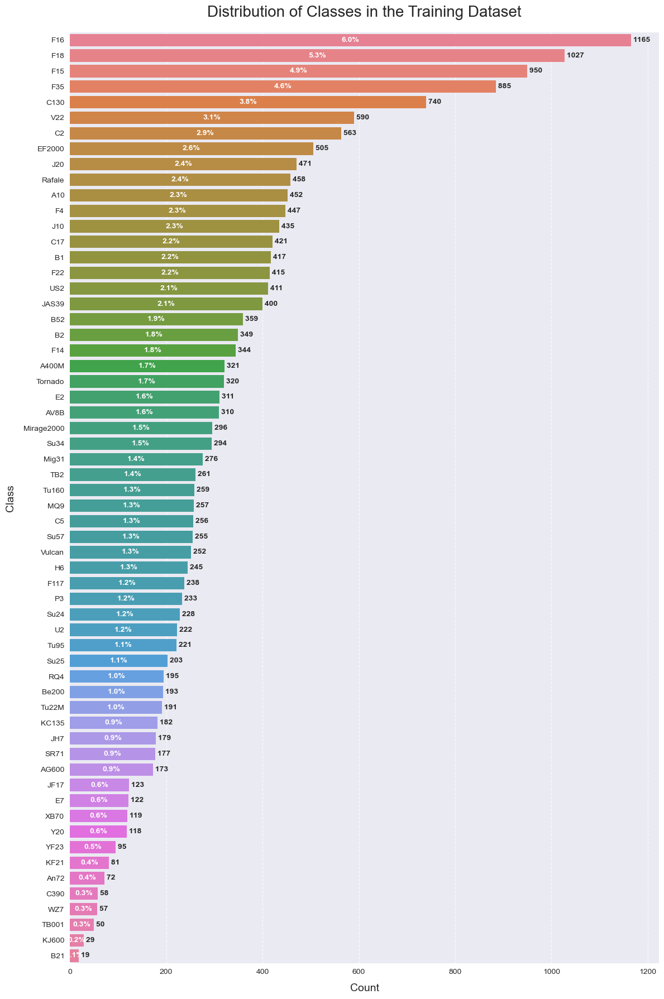

Total number of samples: 19295
Number of classes: 60
Most common class: F16 (1165 samples, 6.04%)
Least common class: B21 (19 samples, 0.10%)
Imbalance ratio (most common / least common): 61.32


In [46]:
# Call the function for both train and validation datasets
print("Training Dataset Distribution:")
visualize_label_distribution(train_df, class_names, "Distribution of Classes in the Training Dataset")


Validation Dataset Distribution:


2024-08-05 12:51:44.854677: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype int32 and shape [8269]
	 [[{{node Placeholder/_4}}]]
2024-08-05 12:51:44.854884: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_4' with dtype int32 and shape [8269]
	 [[{{node Placeholder/_4}}]]


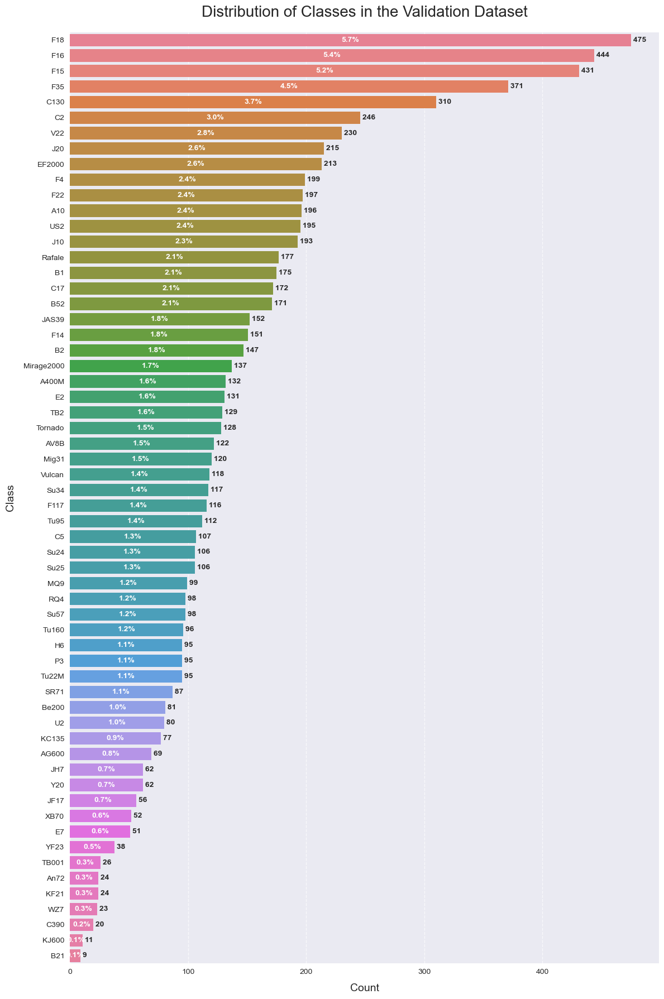

Total number of samples: 8269
Number of classes: 60
Most common class: F18 (475 samples, 5.74%)
Least common class: B21 (9 samples, 0.11%)
Imbalance ratio (most common / least common): 52.78


In [47]:
print("\nValidation Dataset Distribution:")
visualize_label_distribution(validation_df, class_names, "Distribution of Classes in the Validation Dataset")

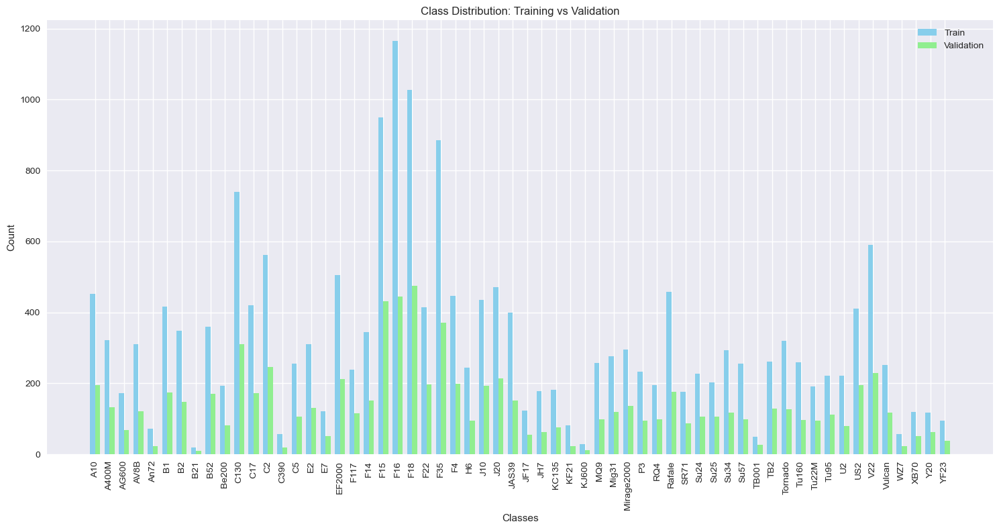

In [48]:
compare_class_distribution(train_df, validation_df, class_names)

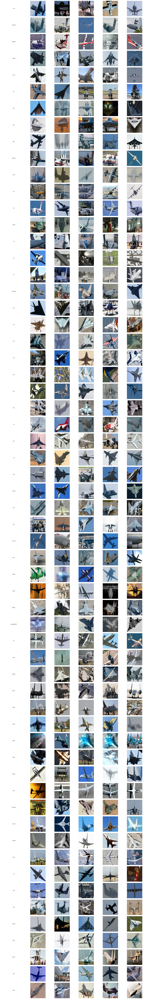

In [49]:
visualize_sample_images_vertical(train_df, class_names, samples_per_class=5)

## Do we have a lot of details on our images?

Let's try to use:
- Edge Detection (Sobel filter)
- Frequency Domain Analysis (Fourier Transform)

In [50]:
# Edge Detection:
# Ccounting the number of edges in an image. 
# More edges often correlate with more details.
def tf_edge_detection(image):
    # Ensure the image has a batch dimension and channel dimension
    if len(image.shape) == 2:
        image = image[tf.newaxis, ..., tf.newaxis]
    elif len(image.shape) == 3:
        image = image[..., tf.newaxis]
    
    # Apply Sobel filter
    edges = tf.image.sobel_edges(image)
    
    # Separate horizontal and vertical edges
    sobel_x = edges[..., 0]
    sobel_y = edges[..., 1]
    
    # Compute edge magnitude
    edge_mag = tf.sqrt(tf.square(sobel_x) + tf.square(sobel_y))
    
    # Count edges (you may need to adjust the threshold)
    edge_count = tf.reduce_sum(tf.cast(edge_mag > 0.5, tf.float32))
    
    return edge_count

# Frequency Domain Analysis:
# attempt to use Fourier Transform to analyze the frequency content of the image. 
# Higher frequency components often indicate more details.
def tf_high_frequency_content(image):
    # Apply 2D FFT
    fft = tf.signal.fft2d(tf.cast(tf.squeeze(image), tf.complex64))
    
    # Compute magnitude spectrum
    magnitude_spectrum = tf.abs(fft)
    
    # Sum of high frequency components (you may need to adjust the threshold)
    high_freq_sum = tf.reduce_sum(magnitude_spectrum[100:, 100:])
    
    return high_freq_sum


In [51]:
detail_metrics = []

for images, _ in train_df:
    for image in images:
        # Convert to grayscale if it's a color image
        # Add batch dimension if it's a single image
        if len(image.shape) == 3:
            image = tf.expand_dims(image, axis=0)
        image = tf.image.rgb_to_grayscale(image)
        
        edge_count = tf_edge_detection(image)
        high_freq = tf_high_frequency_content(image)
        
        detail_metrics.append({
            'edge_count': edge_count.numpy(),
            'high_freq': high_freq.numpy(),
        })

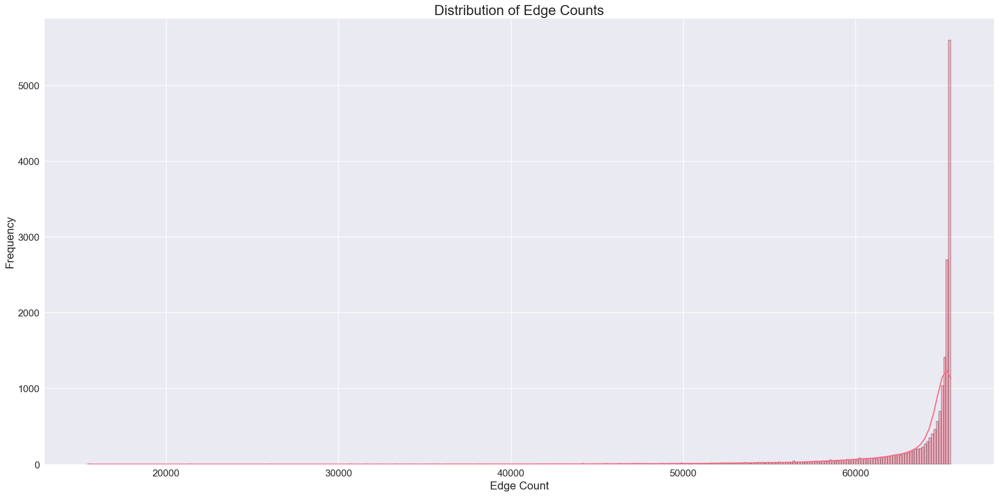

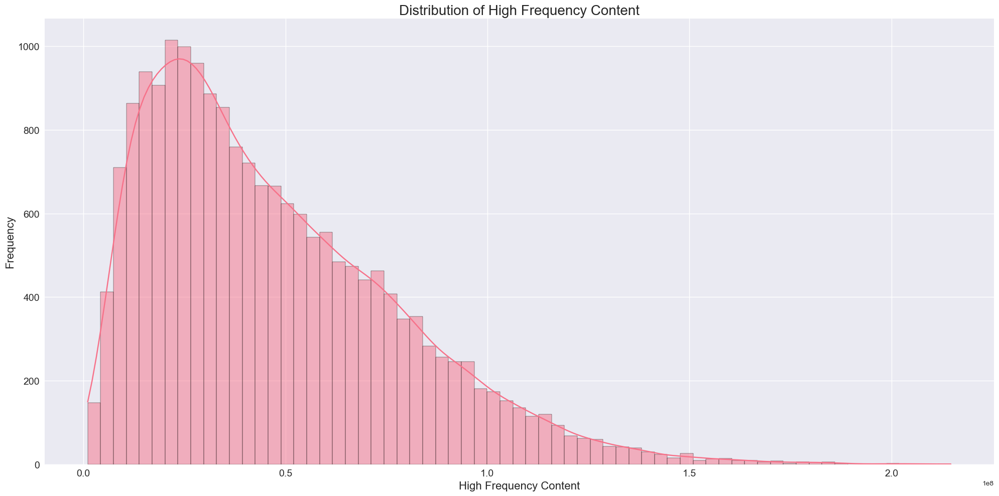

         edge_count    high_freq
count  19295.000000      19295.0
mean   63516.597656   47098792.0
std     3797.863525   30938556.0
min    15454.000000    1065016.5
25%    63515.000000   22899534.0
50%    65113.000000   40174044.0
75%    65412.000000   65931612.0
max    65529.000000  214687760.0


In [52]:
# Convert the list of dictionaries to a pandas DataFrame
df = pd.DataFrame(detail_metrics)

# Set up the style for the plots
plt.style.use('seaborn')
sns.set_palette("husl")

# Create a figure for edge count
plt.figure(figsize=(20, 10))
sns.histplot(data=df, x='edge_count', kde=True)
plt.title('Distribution of Edge Counts', fontsize=20)
plt.xlabel('Edge Count', fontsize=16)
plt.ylabel('Frequency', fontsize=16)
plt.tick_params(labelsize=14)
plt.tight_layout()
plt.show()

# Create a figure for high frequency content
plt.figure(figsize=(20, 10))
sns.histplot(data=df, x='high_freq', kde=True)
plt.title('Distribution of High Frequency Content', fontsize=20)
plt.xlabel('High Frequency Content', fontsize=16)
plt.ylabel('Frequency', fontsize=16)
plt.tick_params(labelsize=14)
plt.tight_layout()
plt.show()

# Print some summary statistics
print(df.describe())

## Summary:

- DS is not clean - there is a lot of different redundant details on images
- Aircraft images are not consistent - the photos made from different angels
- We have a huge difference in the number of photos in each class
- Also test dataset has another "proportions" in number of images per class
- The number of "details" is high but quite different for images (Distribution of High Frequency Content)

### interesing note: 256x256 provide more deatails than 128x128 - like it was predictable, but now I saw this on graphics

# What I think about this dataset

![](this-is-fine.webp)
![](meme_sad_frog.png)
